In [1]:
import numpy as np
import matplotlib.pyplot as plt
import random

[3.79908201e+000 2.86164880e+000 6.76164599e-001 ... 3.93566442e-135
 5.85088563e-135 1.98749535e-134]


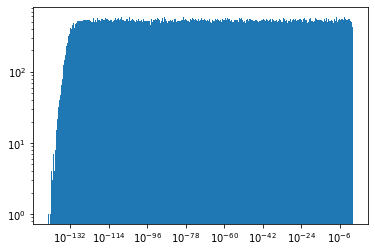

In [2]:
iteration = 500
numSteps = 1000
initMass = 10
masses = np.array([initMass])
fullMass = np.array([])
idx = 0
param = 1

for i in range(iteration):
    for j in range(numSteps):
        split = random.uniform(0,1)
        masses = np.append(masses, masses[idx] * (1-split))
        masses[idx] = masses[idx] * split
        if random.uniform(0,1) < param:
            if split < 0.5:
                idx = len(masses) - 1
        else:
            if split > 0.5:
                idx = len(masses) - 1
    fullMass = np.append(fullMass, masses)
    masses = np.array([initMass])
    idx = 0

print(fullMass)
logbins = np.logspace(np.log10(min(fullMass)), np.log10(1.0), 1000)

plt.hist(fullMass, bins=logbins)
plt.xscale('log')
plt.yscale('log')
plt.show()





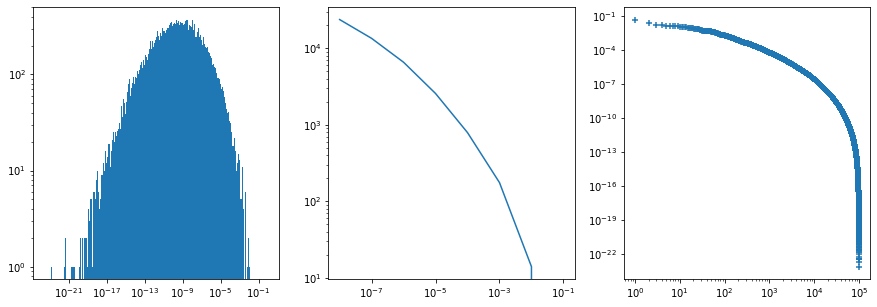

In [16]:
iteration = 1
numSteps = 10**5
initMass = 1
masses = np.array([initMass])
fullMass = np.array([])
idx = 0

fig, ax = plt.subplots(1,3,figsize=(15,5))
for i in range(iteration):
    for j in range(numSteps):
        idx = random.randint(0,len(masses)-1)
        split = random.uniform(0,1)
        masses = np.append(masses, masses[idx] * (1-split))
        masses[idx] = masses[idx] * split
    fullMass = np.append(fullMass, masses)
    masses = np.array([initMass])
    idx = 0


logbins = np.logspace(np.log10(min(fullMass)), np.log10(1.0), 1000)
ax[0].hist(fullMass, bins=logbins)
ax[0].set_xscale('log')
ax[0].set_yscale('log')
plot_size = int(np.log10(sim_size*1000)) # factor adds OOM to the plots
plot_x = [0]*plot_size
plot_y = [0]*plot_size
plot_count = 0
# print(sum(sim_space)) # check
while plot_count < plot_size:
    plot_power = 1/(10**(plot_count+1))
    plot_x[plot_count] = plot_power
    plot_y[plot_count] = len([i for i in sim_space if i > plot_power]) # https://www.geeksforgeeks.org/python-number-of-values-greater-than-k-in-list/
    plot_count+=1

# plotting log-log
ax[1].set_xscale('log')
ax[1].set_yscale('log')
ax[1].plot(plot_x, plot_y)

ccdf = np.sort(sim_space)[::-1]
ranks = np.arange(1, len(ccdf)+1)

ax[2].scatter(ranks, ccdf, marker='+')
ax[2].set_xscale('log')
ax[2].set_yscale('log')




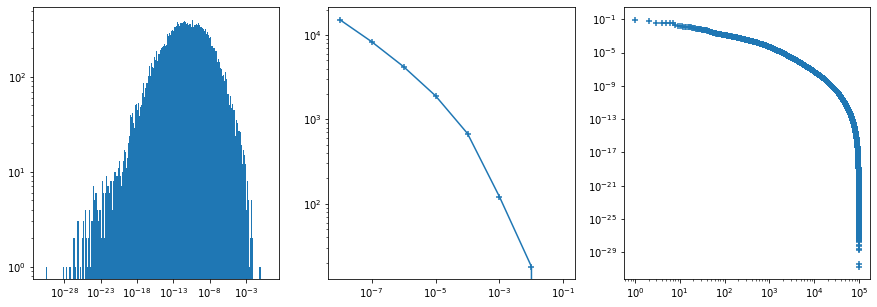

In [7]:
fig, ax = plt.subplots(1,3,figsize=(15,5))
# setup space
sim_size = 10**5
sim_space = [0]*sim_size
sim_count = 0
sim_space[sim_count] = 1
# print(sim_space) # check

# fraction space for one out of simcount+1 elements
while sim_count < sim_size-1:
    rnd_position = random.randint(0,sim_count)
    rnd_fraction = random.random()
    sim_space[sim_count+1]  = sim_space[rnd_position]*(1-rnd_fraction)
    sim_space[rnd_position] = sim_space[rnd_position]*rnd_fraction
    sim_count+=1
    # print(sim_space) # check

# check
ax[0].set_xscale('log')
ax[0].set_yscale('log')
logbins = np.logspace(np.log10(min(sim_space)), np.log10(1.0), 1000)
ax[0].hist(sim_space, bins=logbins)

plot_size = int(np.log10(sim_size*1000)) # factor adds OOM to the plots
plot_x = [0]*plot_size
plot_y = [0]*plot_size
plot_count = 0
# print(sum(sim_space)) # check
while plot_count < plot_size:
    plot_power = 1/(10**(plot_count+1))
    plot_x[plot_count] = plot_power
    plot_y[plot_count] = len([i for i in sim_space if i > plot_power]) # https://www.geeksforgeeks.org/python-number-of-values-greater-than-k-in-list/
    plot_count+=1

# plotting log-log
ax[1].set_xscale('log')
ax[1].set_yscale('log')
ax[1].plot(plot_x, plot_y)
ax[1].scatter(plot_x, plot_y, marker='+')

ccdf = np.sort(sim_space)[::-1]
ranks = np.arange(1, len(ccdf)+1)

ax[2].scatter(ranks, ccdf, marker='+')
ax[2].set_xscale('log')
ax[2].set_yscale('log')
# output for one run:
# [0.1, 0.01, 0.001, 0.0001, 1e-05, 1e-06, 1e-07, 1e-08, 1e-09]
# [1, 13, 129, 831, 4154, 15869, 44950, 101325, 190545]

[3.459832768690533e-09, 6.8895002018818875e-09, 2.2835153740914278e-10, 2.021193405740243e-09, 5.0888837160219155e-09, 3.3268877689488256e-09, 1.3434230900080404e-08, 1.8590472118893927e-09, 3.433286540467461e-09, 8.088951436404508e-09, 3.3942109331301733e-09, 3.9750754665020945e-09, 8.380805850101333e-11, 7.644913236309475e-10, 1.746143643055098e-09, 9.059832638521847e-09, 5.154909116384547e-10, 3.701126845517718e-10, 9.784585620152687e-11, 3.2214124916704225e-11, 3.3071314574372913e-07, 7.55672136545129e-09, 2.5895745536008405e-07, 3.3681934872168887e-06, 1.807063482301402e-08, 8.211496922372219e-08, 1.21649022482875e-07, 1.0161932731862263e-07, 7.66837241705804e-08, 6.17416356804632e-08, 6.524759209437479e-08, 7.906158786869875e-08, 1.199816671687451e-09, 1.0490049326348858e-08, 2.329765736011035e-10, 5.222788833980294e-09, 1.7590552187331406e-09, 5.311915153511539e-12, 7.808242277799891e-12, 6.536145783615447e-10, 8.149556106544101e-10, 8.201776660692286e-10, 5.298369676395485e-11,

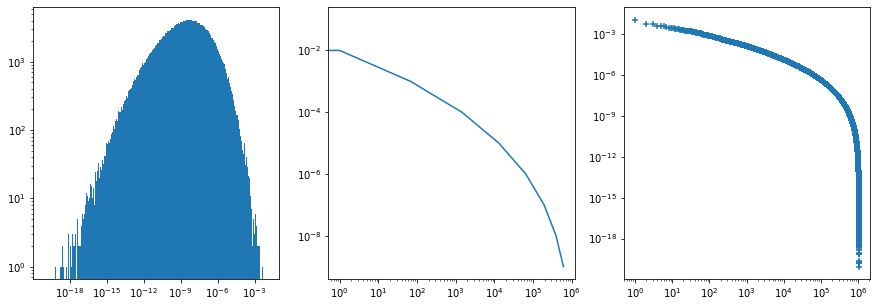

In [8]:
fig, ax = plt.subplots(1,3,figsize=(15,5))
curr_mass = []
next_mass = []
numSteps = 20
initMass = 1
curr_mass.append(initMass)
for i in range(numSteps):
    for j in range(len(curr_mass)):
        split = random.uniform(0,1)
        next_mass.append(curr_mass[j] * (1-split))
        next_mass.append(curr_mass[j] * split)
    curr_mass = next_mass
    next_mass = []   
print(curr_mass)
ax[0].set_xscale('log')
ax[0].set_yscale('log')
logbins = np.logspace(np.log10(min(curr_mass)), np.log10(max(curr_mass)), 1000)
ax[0].hist(curr_mass, bins=logbins)

plot_size = int(np.log10(2**numSteps *1000)) # factor adds OOM to the plots
plot_x = [0]*plot_size
plot_y = [0]*plot_size
plot_count = 0
# print(sum(sim_space)) # check
while plot_count < plot_size:
    plot_power = 1/(10**(plot_count+1))
    plot_x[plot_count] = plot_power
    plot_y[plot_count] = len([i for i in curr_mass if i > plot_power]) # https://www.geeksforgeeks.org/python-number-of-values-greater-than-k-in-list/
    plot_count+=1

# plotting log-log
ax[1].set_xscale('log')
ax[1].set_yscale('log')
ax[1].plot(plot_y, plot_x)

ccdf = np.sort(curr_mass)[::-1]
ranks = np.arange(1, len(ccdf)+1)

ax[2].scatter(ranks, ccdf, marker='+')
ax[2].set_xscale('log')
ax[2].set_yscale('log')
